# DDPM vs DDIM Spiral Sampling

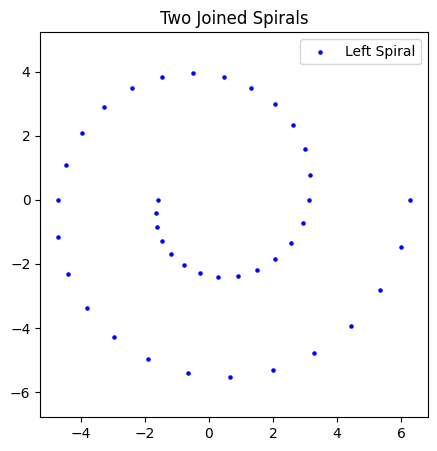

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def powspace(start, stop, power, num):
    start = np.power(start, 1/float(power))
    stop = np.power(stop, 1/float(power))
    return np.power(np.linspace(start, stop, num=num), power)

def generate_spiral(n_points, start=np.pi, end=4 * np.pi, pow=1, weighted_region=(None, None), weight=1, mirror=False):
    theta = powspace(start, end, pow, n_points)

    if weighted_region[0] is not None and weighted_region[1] is not None:
        mask = (theta >= weighted_region[0]) & (theta <= weighted_region[1])
        reps = np.where(mask, weight, 1)
        theta = np.repeat(theta, reps)

    r = theta
    x = r * np.cos(theta) / 2
    y = r * np.sin(theta) / 2
    data = np.stack([x, y], axis=1)

    if not mirror:
      return data

    # Calculate the maximum x-value from the original spiral
    max_x = np.max(data[:, 0])

    # Create the left spiral by shifting the original spiral left by max_x
    spiral_left = data.copy()
    spiral_left[:, 0] -= max_x

    # Create the right spiral by copying the original, flipping it along the y axis,
    # and then shifting it right by max_x.
    spiral_right = data.copy()
    spiral_right[:, 0] = -spiral_right[:, 0] + max_x
    spiral_right[:, 1] = -spiral_right[:, 1]

    combined_spiral = np.vstack((spiral_left, spiral_right))
    return combined_spiral


spiral_data = generate_spiral(40)
# Plot both spirals
plt.figure(figsize=(5, 5))
plt.scatter(spiral_data[:, 0], spiral_data[:, 1], s=5, color='blue', label='Left Spiral')
plt.title("Two Joined Spirals")
plt.legend()
plt.axis("equal")
plt.show()

In [3]:
import torch
import torch.nn as nn

class DiffusionModel(nn.Module):
    def __init__(self, time_embedding_dim=16, hidden_dim=128, num_layers=4):
        super().__init__()
        self.time_embedding = nn.Sequential(
            nn.Linear(1, time_embedding_dim),
            nn.ReLU(),
            nn.Linear(time_embedding_dim, time_embedding_dim)
        )
        layers = [
            nn.Linear(2 + time_embedding_dim, hidden_dim),
            nn.ReLU(),
        ] + num_layers * [
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
        ] + [
            nn.Linear(hidden_dim, 2)
        ]
        self.net = nn.Sequential(*layers)

    def forward(self, x, t):
        t_emb = self.time_embedding(t)
        x_input = torch.cat([x, t_emb], dim=1)
        return self.net(x_input)

In [22]:
# Number of time steps
T = 1000
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

def get_diffusion_params(T, device):
    betas = np.linspace(1e-4, 0.02, T)  # from a small number to 0.02
    # betas = np.linspace(1e-3, 0.002, T)  # from a small number to 0.05
    alphas = 1 - betas
    alpha_bars = np.cumprod(alphas)
    betas = torch.tensor(betas, dtype=torch.float32).to(device)
    alphas = torch.tensor(alphas, dtype=torch.float32).to(device)
    alpha_bars = torch.tensor(alpha_bars, dtype=torch.float32).to(device)
    return betas, alphas, alpha_bars


In [5]:
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

def train_model_on_spiral(n_points, spiral_start=np.pi, spiral_end=8*np.pi, spiral_pow=1, spiral_weighted_region=(None, None), spiral_weight=1, num_epochs=5000, T=1000, batch_size=128, device=torch.device("cuda" if torch.cuda.is_available() else "cpu"), print_every=1000):
    # Generate spiral data
    spiral_data = generate_spiral(n_points=n_points, start=spiral_start, end=spiral_end, pow=spiral_pow, weighted_region=spiral_weighted_region, weight=spiral_weight)
    data_tensor = torch.tensor(spiral_data, dtype=torch.float32)
    dataset = TensorDataset(data_tensor)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

    # Get diffusion parameters
    betas, alphas, alpha_bars = get_diffusion_params(T, device)

    # q_sample: forward diffusion (adding noise)
    def q_sample(x0, t, noise):
        # Use the precomputed alpha_bars
        sqrt_alpha_bar = torch.sqrt(alpha_bars[t]).unsqueeze(1)  # shape (batch, 1)
        sqrt_one_minus_alpha_bar = torch.sqrt(1 - alpha_bars[t]).unsqueeze(1)
        return sqrt_alpha_bar * x0 + sqrt_one_minus_alpha_bar * noise

    # Instantiate model and optimizer
    model = DiffusionModel().to(device)
    optimizer = optim.Adam(model.parameters(), lr=1e-3)

    # Training loop
    model.train()
    for epoch in range(1, num_epochs + 1):
        total_loss = 0
        for (x0,) in dataloader:
            x0 = x0.to(device)
            batch_size_cur = x0.size(0)

            for _ in range(T):
              t = torch.randint(0, T, (batch_size_cur,), device=device)
              noise = torch.randn_like(x0)
              x_t = q_sample(x0, t, noise)
              t_norm = (t.float() / T).unsqueeze(1)
              noise_pred = model(x_t, t_norm)
              loss = ((noise_pred - noise)**2).mean()

              total_loss += loss.item()
              optimizer.zero_grad()
              loss.backward()
              optimizer.step()

        avg_loss = total_loss / (T * len(dataloader))
        if epoch % print_every == 0 or epoch == 1:
            print(f"[n_points={n_points}] Epoch {epoch}/{num_epochs}, loss: {loss.item():.4f}")

    return model, betas, alphas, alpha_bars, spiral_data

In [6]:
@torch.no_grad()
def sample_ddpm(model, num_samples, T, betas, alphas, alpha_bars, device):
    model.eval()
    # Start from pure noise
    x = torch.randn(num_samples, 2, device=device)
    # x = torch.rand(num_samples, 2, device=device) * 10 - 5
    samples = [x.cpu().numpy()]

    for t in reversed(range(1, T)):
        t_tensor = torch.full((num_samples, 1), t / T, device=device)
        # Predict noise at this time step
        eps = model(x, t_tensor)

        beta_t = betas[t]
        alpha_t = alphas[t]
        alpha_bar_t = alpha_bars[t]
        alpha_bar_t_minus_one = alpha_bars[t - 1]

        z = torch.randn_like(x)
        # Estimate x0 (the original signal)
        x0 = (1 / torch.sqrt(alpha_bar_t)) * (x - (torch.sqrt(1 - alpha_bar_t) * eps))
        # Compute the mean of the reverse process
        mu = (torch.sqrt(alpha_t) * (1 - alpha_bar_t_minus_one) / (1 - alpha_bar_t)) * x + \
             (torch.sqrt(alpha_bar_t_minus_one) * beta_t / (1 - alpha_bar_t)) * x0

        noise = torch.sqrt(beta_t * (1 - alpha_bar_t_minus_one) / (1 - alpha_bar_t)) * z
        x = mu + noise
        samples.append(x.cpu().numpy())

    return np.array(samples)

@torch.no_grad()
def sample_ddim(model, num_samples, T, alpha_bars, device):
    model.eval()
    x = torch.randn(num_samples, 2, device=device)
    # x = torch.rand(num_samples, 2, device=device) * 10 - 5
    samples = [x.cpu().numpy()]

    for t in reversed(range(1, T)):
        t_tensor = torch.full((num_samples, 1), t / T, device=device)
        eps = model(x, t_tensor)

        alpha_bar_t = alpha_bars[t]
        sqrt_alpha_bar_t = torch.sqrt(alpha_bar_t)
        sqrt_one_minus_alpha_bar_t = torch.sqrt(1 - alpha_bar_t)
        # Predict x0
        x0_pred = (x - sqrt_one_minus_alpha_bar_t * eps) / sqrt_alpha_bar_t

        alpha_bar_prev = alpha_bars[t - 1]
        sqrt_alpha_bar_prev = torch.sqrt(alpha_bar_prev)
        sqrt_one_minus_alpha_bar_prev = torch.sqrt(1 - alpha_bar_prev)
        # Compute new x without adding extra noise (deterministic update)
        x = sqrt_alpha_bar_prev * x0_pred + sqrt_one_minus_alpha_bar_prev * eps
        samples.append(x.cpu().numpy())

    return np.array(samples)

In [7]:
def plot_denoiser_flow(model, grid_points, T, alpha_bars, arrows=True, device=None):
    """
    Given a set of grid points and a trained neural network denoiser 'model',
    compute the denoised outputs for 25 evenly spaced timesteps between t=1 and t=0.
    For each timestep, plot arrows from the original grid point x to the output y = model(x, t).
    Arrows are colored according to their length (red for longer, blue for shorter).

    Parameters:
      - model: a torch.nn.Module that takes inputs (x, t) where x is a (N,2) tensor and
               t is a (N,1) tensor of normalized timesteps.
      - grid_points: numpy array of shape (N,2) representing the grid points.
      - T: total number of diffusion steps (used to compute actual timesteps).
      - device: torch device; if None, it will use cuda if available.
    """
    import matplotlib as mpl

    if device is None:
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Convert grid points to tensor and send to device.
    grid_tensor = torch.tensor(grid_points, dtype=torch.float32, device=device)
    time_indices = np.linspace(T - 1, 0, 25, dtype=int)
    cmap = plt.cm.RdBu

    fig, axes = plt.subplots(5, 5, figsize=(25, 25))
    axes = axes.flatten()

    # Compute common axis limits for all subplots.
    x_min, x_max = grid_points[:, 0].min(), grid_points[:, 0].max()
    y_min, y_max = grid_points[:, 1].min(), grid_points[:, 1].max()

    model.eval()
    with torch.no_grad():
        for i, t in enumerate(time_indices):
            t_val = t / T
            t_tensor = torch.full((grid_tensor.shape[0], 1), t_val, device=device)
            alpha_bar_t = alpha_bars[t]

            eps = model(grid_tensor, t_tensor)
            x0 = (1 / torch.sqrt(alpha_bar_t)) * (grid_tensor - (torch.sqrt(1 - alpha_bar_t) * eps))

            y_np = x0.cpu().numpy()
            # Compute differences: arrow components.
            dx = y_np[:, 0] - grid_points[:, 0]
            dy = y_np[:, 1] - grid_points[:, 1]

            # Calculate arrow lengths and determine colors.
            lengths = np.sqrt(dx**2 + dy**2)
            norm = mpl.colors.Normalize(vmin=lengths.min(), vmax=lengths.max())
            colors = cmap(norm(lengths))

            ax = axes[i]
            if arrows:
                ax.quiver(grid_points[:, 0], grid_points[:, 1],
                          dx, dy,
                          color=colors,
                          angles='xy', scale_units='xy', scale=1,
                          width=0.0025, headwidth=4, headlength=5)

            ax.scatter(y_np[:, 0], y_np[:, 1], s=7)

            ax.set_title(f"t = {t_val:.2f}", fontsize=12)
            ax.set_aspect('equal')
            ax.set_xlim(x_min, x_max)
            ax.set_ylim(y_min, y_max)
            ax.set_xlabel("x", fontsize=10)
            ax.set_ylabel("y", fontsize=10)
            ax.tick_params(axis='both', which='major', labelsize=10)

    fig.suptitle("Denoiser $x_0$ predictions over time", fontsize=20)
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    plt.show()

In [8]:
def create_plots_for_n_points(n_points_list, spiral_start=np.pi, spiral_end=4*np.pi, spiral_pow=1, spiral_weighted_region=(None, None), spiral_weight=1,
                              num_epochs=5000, T=1000, ddpm_num_samples=500, ddim_num_samples=500,
                              batch_size=128, device=torch.device("cuda" if torch.cuda.is_available() else "cpu")):
    m = len(n_points_list)
    # Create a figure with m rows and 3 columns
    fig, axes = plt.subplots(nrows=m, ncols=3, figsize=(15, 5*m))

    # If there's only one row, axes will be 1D so adjust accordingly:
    if m == 1:
        axes = np.expand_dims(axes, axis=0)

    for i, n_points in enumerate(n_points_list):
        print(f"\nProcessing n_points = {n_points}")
        # Train a diffusion model on the spiral data
        model, betas, alphas, alpha_bars, spiral_data = train_model_on_spiral(
            n_points, spiral_start=spiral_start, spiral_end=spiral_end, spiral_pow=spiral_pow, spiral_weighted_region=spiral_weighted_region, spiral_weight=spiral_weight, num_epochs=num_epochs, T=T, batch_size=batch_size, device=device)

        # -------------------------
        # Column 1: Plot the Spiral Data
        # -------------------------
        ax_spiral = axes[i, 0]
        ax_spiral.scatter(spiral_data[:, 0], spiral_data[:, 1], s=1, color="black")
        ax_spiral.set_title(f"Spiral (n_points={n_points})")
        ax_spiral.axis("equal")

        # -------------------------
        # Column 2: Generate and Plot DDPM Samples
        # -------------------------
        samples_ddpm = sample_ddpm(model, ddpm_num_samples, T, betas, alphas, alpha_bars, device)
        ax_ddpm = axes[i, 1]

        for j in range(ddpm_num_samples):
          traj = samples_ddpm[:, j, :]
          ax_ddpm.plot(traj[:, 0], traj[:, 1], lw=0.01, color="blue", alpha=0.5)
          ax_ddpm.plot(traj[-1, 0], traj[-1, 1], 'o', markersize=0.5, color="black")

        # For visualization we take the final time step samples.
        ax_ddpm.set_title("DDPM Samples")
        ax_ddpm.axis("equal")

        # -------------------------
        # Column 3: Generate and Plot DDIM Samples
        # -------------------------
        samples_ddim = sample_ddim(model, ddim_num_samples, T, alpha_bars, device)
        ax_ddim = axes[i, 2]
        for j in range(ddim_num_samples):
          traj = samples_ddim[:, j, :]
          ax_ddim.plot(traj[:, 0], traj[:, 1], lw=0.15, color="blue", alpha=0.5)
          ax_ddim.plot(traj[-1, 0], traj[-1, 1], 'o', markersize=0.5, color="black")

        ax_ddim.set_title("DDPM Samples")
        ax_ddim.axis("equal")

    plt.tight_layout()
    plt.show()

In [ ]:
# create_plots_for_n_points([10, 20, 40], spiral_start=np.pi, spiral_end=4 * np.pi, num_epochs=10000, spiral_pow=1)
create_plots_for_n_points([10, 20, 30], spiral_start=np.pi, spiral_end=4 * np.pi, num_epochs=10000, spiral_pow=0.5, T=200)

In [ ]:
create_plots_for_n_points([50, 100, 150], spiral_start=np.pi, spiral_end=8 * np.pi, num_epochs=15000, batch_size=64, ddpm_num_samples=2500, ddim_num_samples=2500)

In [10]:
T = 800
num_epochs = 150

model, betas, alphas, alpha_bars, spiral_data = train_model_on_spiral(
    n_points=50,
    spiral_start=np.pi,
    spiral_end=4 * np.pi,
    spiral_pow=0.5,
    num_epochs=num_epochs,
    T=T,
    print_every=int(num_epochs/20)
)

[n_points=50] Epoch 1/150, loss: 0.4733
[n_points=50] Epoch 7/150, loss: 0.3117
[n_points=50] Epoch 14/150, loss: 0.3865
[n_points=50] Epoch 21/150, loss: 0.1289
[n_points=50] Epoch 28/150, loss: 0.2895
[n_points=50] Epoch 35/150, loss: 0.2420
[n_points=50] Epoch 42/150, loss: 0.2317
[n_points=50] Epoch 49/150, loss: 0.1171
[n_points=50] Epoch 56/150, loss: 0.2294
[n_points=50] Epoch 63/150, loss: 0.1892
[n_points=50] Epoch 70/150, loss: 0.1470
[n_points=50] Epoch 77/150, loss: 0.3696
[n_points=50] Epoch 84/150, loss: 0.2728
[n_points=50] Epoch 91/150, loss: 0.1858
[n_points=50] Epoch 98/150, loss: 0.1758
[n_points=50] Epoch 105/150, loss: 0.4869
[n_points=50] Epoch 112/150, loss: 0.1781
[n_points=50] Epoch 119/150, loss: 0.2327
[n_points=50] Epoch 126/150, loss: 0.1045
[n_points=50] Epoch 133/150, loss: 0.2114
[n_points=50] Epoch 140/150, loss: 0.1658
[n_points=50] Epoch 147/150, loss: 0.2921


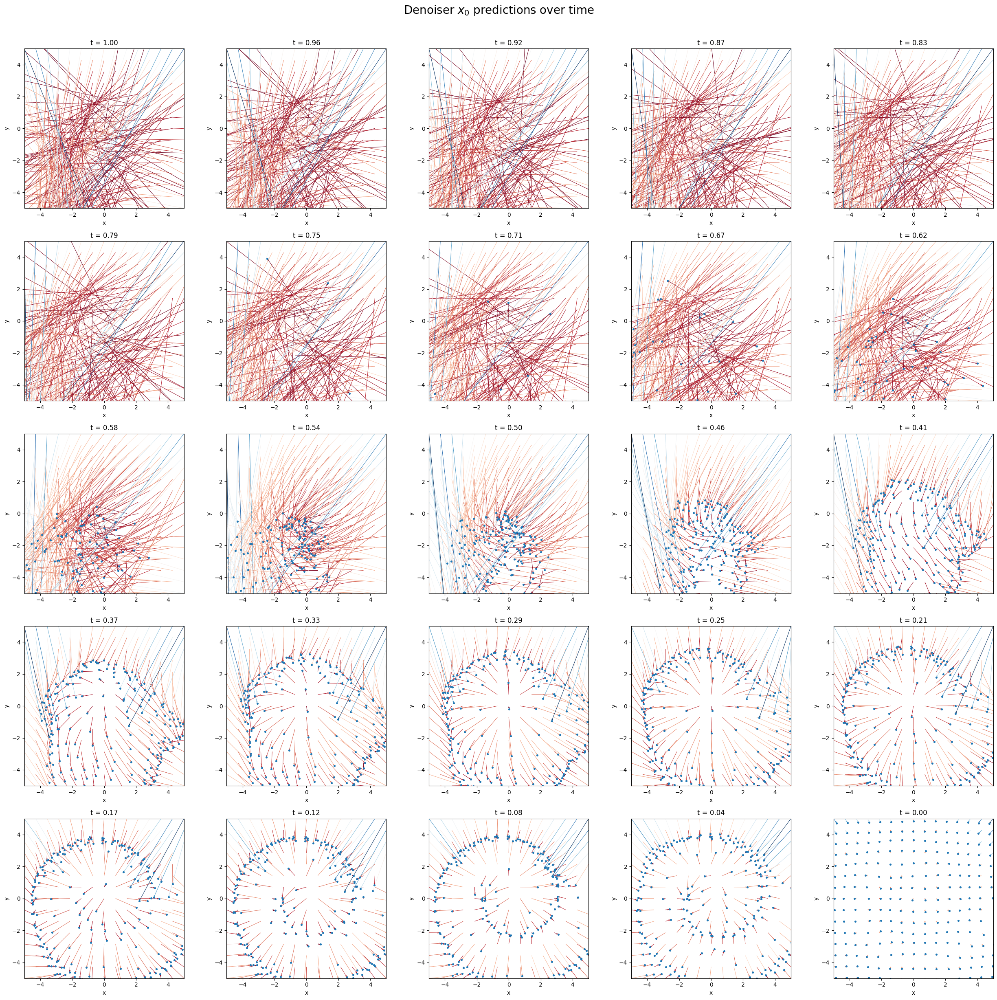

In [12]:
# grid_vals = np.linspace(-5, 5, 10)
grid_vals = np.linspace(-5, 5, 15)
grid_x, grid_y = np.meshgrid(grid_vals, grid_vals)
grid_points = np.stack([grid_x.flatten(), grid_y.flatten()], axis=1)

plot_denoiser_flow(model, grid_points, T, alpha_bars, arrows=True)

# Analytical Stuff

## Computing $ \mathbb{E}[X \mid y] $ for a Discrete Spiral

In this example, our true data lies on a spiral in the xy-plane. We assume we have a discrete set of 5 data points sampled from the spiral. Given any query point $y$ in the plane, we want to compute the conditional expectation:

$
\mathbb{E}[X \mid y] = \frac{\sum_{i=1}^5 x_i\, \exp\!\left(-\frac{\|y - x_i\|^2}{2\sigma^2}\right)}{\sum_{i=1}^5 \exp\!\left(-\frac{\|y - x_i\|^2}{2\sigma^2}\right)}
$

This can be interpreted as a soft, Gaussian-weighted projection of $y$ onto the spiral.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

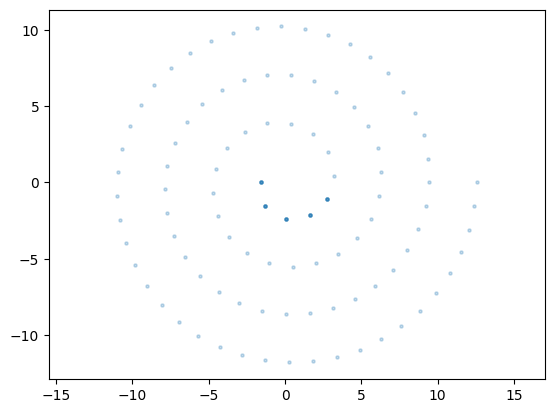

In [ ]:
# Parameters for the spiral
x_points = generate_spiral(100, np.pi, 8 * np.pi, 0.5, weighted_region=(3, 6), weight=5)

plt.axis('equal')
plt.scatter(x_points[:, 0], x_points[:, 1], s=5, alpha=0.25)

## Define the Function to Compute $\mathbb{E}[X \mid y]$

Given a query point $y$, a set of data points `x_points`, and noise level `sigma`, the conditional expectation is computed by:

$
\mathbb{E}[X \mid y] = \frac{\sum_{i} x_i\, \exp\!\left(-\frac{\|y - x_i\|^2}{2\sigma^2}\right)}{\sum_{i} \exp\!\left(-\frac{\|y - x_i\|^2}{2\sigma^2}\right)}
$

In [13]:
def compute_E_x_given_y_vectorized(x_points, sigma, grid_points):
    diff = grid_points[:, None, :] - x_points[None, :, :]
    distances_sq = np.sum(diff**2, axis=2)
    weights = np.exp(-distances_sq / (2 * sigma**2))
    numerator = weights @ x_points
    denominator = np.sum(weights, axis=1, keepdims=True)
    return numerator / denominator

In [14]:
def sample_analytically(x_points, grid_points, T=25, device=None):
    if device is None:
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    x = torch.tensor(grid_points, dtype=torch.float32, device=device)
    samples = [x.cpu().numpy()]

    betas, alphas, alpha_bars = get_diffusion_params(T, device)

    for t in reversed(range(1, T)):
        beta_t = betas[t]
        alpha_t = alphas[t]
        alpha_bar_t = alpha_bars[t]
        alpha_bar_t_prev = alpha_bars[t - 1]

        x_np = x.cpu().numpy()
        sigma = torch.sqrt(beta_t * (1 - alpha_bar_t_prev) / (1 - alpha_bar_t)).item()
        x0_np = compute_E_x_given_y_vectorized(x_points, sigma, x_np)
        x0 = torch.tensor(x0_np, dtype=torch.float32, device=device)

        mu = (torch.sqrt(alpha_t) * (1 - alpha_bar_t_prev) / (1 - alpha_bar_t)) * x \
             + (torch.sqrt(alpha_bar_t_prev) * beta_t / (1 - alpha_bar_t)) * x0

        z = torch.randn_like(x)
        x = mu + sigma * z
        samples.append(x.cpu().numpy())

    return np.array(samples)

In [15]:
def create_plots_for_points_and_sigmas(n_points_list, sigma_list,
                                       spiral_start=np.pi, spiral_end=4*np.pi,
                                       spiral_weighted_region=(None, None), spiral_weight=1,
                                       power=1,
                                       grid_range=(-15, 15), grid_resolution=300):
    rows = len(sigma_list)
    cols = len(n_points_list)

    fig, axes = plt.subplots(rows, cols,
                             figsize=(5 * cols, 5 * rows),
                             constrained_layout=True)

    if rows == 1:
        axes = np.expand_dims(axes, axis=0)
    if cols == 1:
        axes = np.expand_dims(axes, axis=1)

    space = np.linspace(grid_range[0], grid_range[1], grid_resolution)
    grid_x, grid_y = np.meshgrid(space, space)
    grid_points = np.stack([grid_x.flatten(), grid_y.flatten()], axis=1)

    for i, n_points in enumerate(n_points_list):
        x_points = generate_spiral(n_points, spiral_start, spiral_end, power, weighted_region=spiral_weighted_region, weight=spiral_weight)

        for j, sigma in enumerate(sigma_list):
            E_points = compute_E_x_given_y_vectorized(x_points, sigma, grid_points)
            E_x = E_points[:, 0].reshape(grid_x.shape)
            E_y = E_points[:, 1].reshape(grid_y.shape)

            distance = np.sqrt((E_x - grid_x)**2 + (E_y - grid_y)**2)
            max_distance = np.max(distance)
            decay_scale = max_distance / 10 if max_distance != 0 else 1
            brightness = np.exp(-distance / decay_scale)
            brightness = np.clip(brightness, 0, 1)
            brightness = distance / max_distance

            ax = axes[j, i]
            im = ax.imshow(brightness,
                           extent=[grid_range[0], grid_range[1], grid_range[0], grid_range[1]],
                           origin='lower', cmap='gray', aspect='equal')

            points_alpha = 1
            if spiral_weighted_region[0] is not None and spiral_weighted_region[1] is not None and spiral_weight > 1:
              points_alpha = 1/3

            ax.scatter(x_points[:, 0], x_points[:, 1], s=10, color='red',
                       edgecolors='black', linewidth=0.5, label='Spiral Points', zorder=2, alpha=points_alpha)

            ax.set_title(f"n_points = {n_points}, sigma = {sigma}", fontsize=12, pad=8)
            ax.set_xlabel("x", fontsize=10)
            ax.set_ylabel("y", fontsize=10)
            ax.tick_params(axis='both', labelsize=9)
            ax.legend(fontsize=9, loc='upper right', frameon=True)

    cbar = fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.8, pad=0.02)
    cbar.set_label('Brightness (exp decay)', fontsize=12)

    plt.show()

In [16]:
def plot_exy_flow(x_points, grid_points, T, device=None, time_indices=None, arrows=True):
    """
    Plot vector fields using the analytical conditional expectation E[X|Y]
    computed on a grid of points. For each chosen timestep (using the diffusion
    parameters to set the effective noise level sigma), the function computes
    the soft projection of grid points onto the data (x_points) and draws arrows
    from the original grid points to their E[X|Y] predictions.

    Parameters:
      x_points    : numpy array of shape (M,2), the data (e.g. spiral points)
      grid_points : numpy array of shape (N,2) on which to evaluate E[X|Y]
      T           : total number of diffusion timesteps (used to compute sigma)
      device      : torch device; if None, uses cuda if available, else cpu.
      time_indices: list or array of timesteps (integers in [1, T-1]) at which to plot.
                    If None, 25 indices evenly spaced between T-1 and 1 are used.
      arrows      : if True, draws arrow vectors from grid point to E[X|Y]
    """
    import matplotlib as mpl

    if device is None:
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Get diffusion parameters (betas, alphas, alpha_bars) as in your code.
    betas, alphas, alpha_bars = get_diffusion_params(T, device)

    # Choose time indices if not provided.
    if time_indices is None:
        time_indices = np.linspace(T - 1, 1, 25, dtype=int)

    # Prepare a 5x5 grid of subplots (adjust as needed)
    fig, axes = plt.subplots(5, 5, figsize=(20, 20))
    axes = axes.flatten()

    # Determine plotting limits based on both grid and data points.
    all_points = np.vstack([grid_points, x_points])
    x_min, x_max = all_points[:, 0].min(), all_points[:, 0].max()
    y_min, y_max = all_points[:, 1].min(), all_points[:, 1].max()

    cmap = plt.cm.RdBu  # colormap for arrow lengths

    for i, t in enumerate(time_indices):
        # Ensure t is at least 1 (so we can index t-1 safely)
        t = int(max(t, 1))
        t_val = t / T

        # Get the diffusion parameters at time t and t-1:
        beta_t = betas[t]
        alpha_bar_t = alpha_bars[t]
        alpha_bar_t_prev = alpha_bars[t - 1]
        # Compute effective noise level sigma at this step
        sigma = torch.sqrt(beta_t * (1 - alpha_bar_t_prev) / (1 - alpha_bar_t)).item()

        # Compute the analytical conditional expectation at each grid point.
        # This uses your provided compute_E_x_given_y_vectorized.
        x0_pred = compute_E_x_given_y_vectorized(x_points, sigma, grid_points)

        # Compute differences (vector field components)
        dx = x0_pred[:, 0] - grid_points[:, 0]
        dy = x0_pred[:, 1] - grid_points[:, 1]

        # Color arrows by their length
        lengths = np.sqrt(dx**2 + dy**2)
        norm = mpl.colors.Normalize(vmin=lengths.min(), vmax=lengths.max())
        colors = cmap(norm(lengths))

        ax = axes[i]
        if arrows:
            ax.quiver(grid_points[:, 0], grid_points[:, 1],
                      dx, dy,
                      color=colors,
                      angles='xy', scale_units='xy', scale=1,
                      width=0.005, headwidth=5, headlength=6)

        # Plot the projected points for reference.
        ax.scatter(x0_pred[:, 0], x0_pred[:, 1], s=5, color='blue', label=r'$E[X|y]$')
        # Optionally, plot the original grid points in a lighter color.
        # ax.scatter(grid_points[:, 0], grid_points[:, 1], s=2, color='gray', alpha=0.5)

        ax.set_title(f"t = {t_val:.2f}\n sigma = {sigma:.3f}", fontsize=10)
        ax.set_xlim(x_min, x_max)
        ax.set_ylim(y_min, y_max)
        ax.set_aspect('equal')
        ax.tick_params(axis='both', labelsize=8)

    fig.suptitle("Vector Fields of Analytical E[X|y] Over Time", fontsize=20)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

/var/folders/dd/314rfwxx4yngg6mlk2g73z500000gn/T/ipykernel_52442/1668583787.py:7: RuntimeWarning: invalid value encountered in divide
  return numerator / denominator


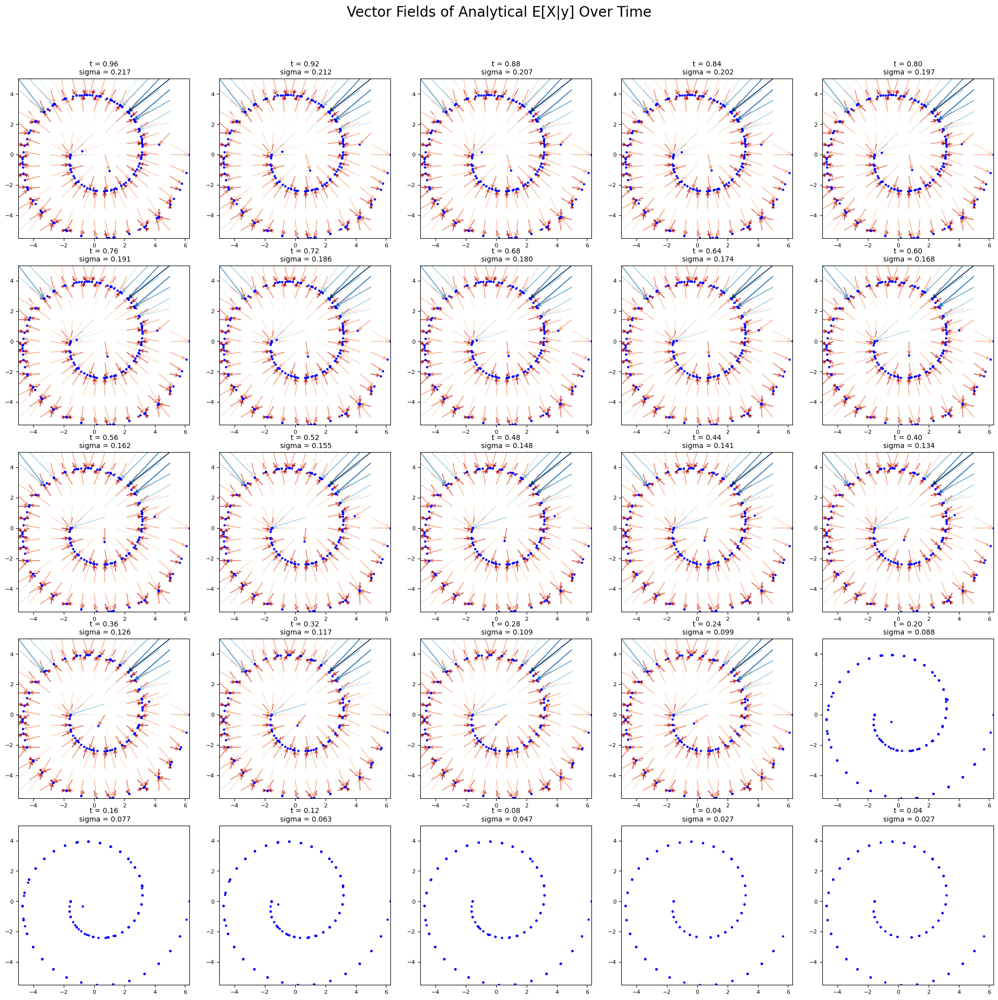

In [ ]:
x_points = generate_spiral(n_points=50, start=np.pi, end=4 * np.pi, pow=1)

# Create a grid of points over the region of interest
grid_vals = np.linspace(-5, 5, 15)
grid_x, grid_y = np.meshgrid(grid_vals, grid_vals)
grid_points = np.stack([grid_x.flatten(), grid_y.flatten()], axis=1)

# Total diffusion steps (you can adjust this parameter)
T = 25

# Plot the analytical E[X|y] vector fields over time
plot_exy_flow(x_points, grid_points, T)

In [ ]:
n_points_list = [40]
sigma_list = [0.05, 0.1, 0.25, 0.44, 0.5]
create_plots_for_points_and_sigmas(n_points_list, sigma_list, spiral_weighted_region=(3, 10), spiral_weight=1)

# Flow Matching

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

In [18]:
class FlowMatchingModel(nn.Module):
    def __init__(self, time_embedding_dim=16, hidden_dim=128, num_layers=8):
        super().__init__()
        self.time_embedding = nn.Sequential(
            nn.Linear(1, time_embedding_dim),
            nn.ReLU(),
            nn.Linear(time_embedding_dim, time_embedding_dim)
        )
        layers = [nn.Linear(2 + time_embedding_dim, hidden_dim), nn.ReLU()]
        for _ in range(num_layers):
            layers.append(nn.Linear(hidden_dim, hidden_dim))
            layers.append(nn.ReLU())
        layers.append(nn.Linear(hidden_dim, 2))
        self.net = nn.Sequential(*layers)

    def forward(self, x, t):
        t_emb = self.time_embedding(t)
        x_input = torch.cat([x, t_emb], dim=1)
        return self.net(x_input)

In [35]:
def train_flow_matching_model_on_spiral(
    n_points,
    T=100,  # number of time steps (hyperparameter)
    num_epochs=5000,
    batch_size=128,
    device=torch.device("cuda" if torch.cuda.is_available() else "cpu"),
    print_every=1000,
    spiral_start=np.pi,
    spiral_end=4*np.pi,
    spiral_pow=1,
    spiral_weighted_region=(None, None),
    spiral_weight=1
):
    # Generate spiral data (x0 samples)
    spiral_data = generate_spiral(n_points=n_points, start=spiral_start, end=spiral_end,
                                  pow=spiral_pow, weighted_region=spiral_weighted_region, weight=spiral_weight)
    data_tensor = torch.tensor(spiral_data, dtype=torch.float32)
    dataset = TensorDataset(data_tensor)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

    model = FlowMatchingModel().to(device)
    optimizer = optim.Adam(model.parameters(), lr=1e-3)
    model.train()

    for epoch in range(1, num_epochs + 1):
        epoch_loss = 0.0
        for (x0_batch,) in dataloader:
            for _ in range(T):
              x0_batch = x0_batch.to(device)  # spiral data: x0
              B = x0_batch.size(0)

              # Sample a discrete time index from 0 to T-1 and normalize it to [0,1]
              t_idx = torch.randint(0, T, (B,), device=device).float()
              t = (t_idx / (T - 1)).unsqueeze(1)  # shape: (B, 1)

              # Sample x1 ~ N(0, I)
              x1 = torch.randn(B, 2, device=device)

              # Compute the interpolated x(t) = (1-t)*x0 + t*x1
              x_t = (1 - t) * x0_batch + t * x1

              # Ground-truth velocity (time derivative) is: d/dt x(t) = x1 - x0 (constant)
              v_target = x0_batch - x1

              # Model prediction for the velocity at (x_t, t)
              v_pred = model(x_t, t)
              loss = ((v_pred - v_target) ** 2).mean()

              optimizer.zero_grad()
              loss.backward()
              optimizer.step()
              epoch_loss += loss.item()

        if epoch % print_every == 0 or epoch == 1:
            avg_loss = epoch_loss / (T * len(dataloader))
            print(f"Epoch {epoch}/{num_epochs}, Loss: {avg_loss:.6f}")

    return model, spiral_data

In [36]:
@torch.no_grad()
def sample_flow_matching(model, num_samples, T=100, device=torch.device("cuda" if torch.cuda.is_available() else "cpu")):
    """
    Sampling via backward integration:
      - Start at t = 1 with x1 ~ N(0,I)
      - Integrate backward (using Euler’s method) over T time steps.
    """
    model.eval()
    # Begin with x1 samples (at t=1)
    x = torch.randn(num_samples, 2, device=device)
    dt = 1.0 / (T - 1)  # time step size
    res = [x.cpu().detach().numpy()]

    # Integrate backwards from t=1 to t=0 (reverse-time ODE)
    for i in range(T):
        t = 1 - i * dt  # current time (normalized)
        t_tensor = torch.full((num_samples, 1), t, device=device)
        # The learned velocity approximates dx/dt at (x, t)
        v = model(x, t_tensor)
        # Reverse Euler update: x = x - v * dt
        x = x + v * dt
        res.append(x.cpu().detach().numpy())
    return np.array(res)


In [ ]:
T = 100
epochs = 1250
epochs = 500

# Train the flow matching model on spiral data (x0) with x1 ~ N(0,I)
model_flow, spiral_data = train_flow_matching_model_on_spiral(
    n_points=40,
    T=T,
    num_epochs=epochs,
    print_every=int(epochs / 20),
    spiral_pow=0.5  # adjust as desired
)

# Generate samples using the learned flow matching model.
num_samples = 1000
samples_flow = sample_flow_matching(model_flow, num_samples, T=T)

# Plot the generated samples (approximate x0)
plt.figure(figsize=(7, 7))
plt.scatter(samples_flow[-1, :, 0], samples_flow[-1, :, 1], s=3, color="blue", label="Flow Matching Samples (x0 estimate)")
plt.title("Samples Generated via Flow Matching")
plt.axis("equal")
plt.legend()
plt.show()

# Combined

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torch

def create_combined_figure(n_points,
                           spiral_start,
                           spiral_end,
                           spiral_pow,
                           sigma,
                           num_samples,
                           spiral_weighted_region=(None, None),
                           spiral_weight=1,
                           num_epochs=10000,
                           T=1000,
                           batch_size=128,
                           grid_range=(-15, 15),
                           grid_resolution=300,
                           sample_grid_resolution=15,
                           noise=0,
                           device=None):
    """
    Creates a 1x4 figure with:
      Column 1: Spiral Data (generated using generate_spiral)
      Column 2: Analytical E[X|Y] brightness (distance-based weighting with sigma)
      Column 3: DDIM sampling trajectories
      Column 4: DDPM sampling trajectories

    Parameters:
      n_points      : number of points in the spiral
      spiral_start  : starting angle for the spiral (in radians)
      spiral_end    : ending angle for the spiral (in radians)
      sigma         : noise level for the analytical model
      num_samples   : number of sampling trajectories for DDIM/DDPM
      num_epochs    : number of training epochs for the diffusion model
      T             : number of diffusion timesteps
      batch_size    : training batch size for the diffusion model
      grid_range    : tuple, (min, max) for the x and y grid in the analytical plot
      grid_resolution: number of grid points along each axis
      noise         : noise level when generating spiral data (should be 0 for a perfect spiral)
      device        : torch.device (if None, will use cuda if available)
    """
    if device is None:
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # --- 1. Train diffusion model on spiral data ---
    # This function (from code1.py) returns the trained model, diffusion parameters, and the spiral data.
    model, betas, alphas, alpha_bars, spiral_data = train_model_on_spiral(
        n_points=n_points,
        spiral_start=spiral_start,
        spiral_end=spiral_end,
        spiral_pow=spiral_pow,
        spiral_weighted_region=spiral_weighted_region,
        spiral_weight=spiral_weight,
        num_epochs=num_epochs,
        T=T,
        batch_size=batch_size,
        device=device
    )

    # --- Create the figure with 4 subplots (1 row x 5 columns) ---
    fig, axes = plt.subplots(1, 5, figsize=(25, 5))

    points_alpha = 1
    if spiral_weighted_region[0] is not None and spiral_weighted_region[1] is not None and spiral_weight > 1:
      points_alpha = 1/3

    # ---- Column 1: Plot the Spiral Data ----
    ax0 = axes[0]
    ax0.scatter(spiral_data[:, 0], spiral_data[:, 1], s=10, color='black', alpha=points_alpha)
    ax0.set_title(f"Spiral Data\n(n_points={n_points}, start={spiral_start:.2f}, end={spiral_end:.2f})")
    ax0.axis("equal")

    # ---- Column 2: Plot the Analytical E[X|Y] Brightness ----
    # Use the spiral data as the set of x_points.
    space = np.linspace(grid_range[0], grid_range[1], grid_resolution)
    grid_x, grid_y = np.meshgrid(space, space)
    grid_points = np.stack([grid_x.flatten(), grid_y.flatten()], axis=1)

    # Compute the conditional expectation for every grid point
    E_points = compute_E_x_given_y_vectorized(spiral_data, sigma, grid_points)
    # Reshape the predicted projection
    E_x = E_points[:, 0].reshape(grid_x.shape)
    E_y = E_points[:, 1].reshape(grid_y.shape)
    # Compute the distance between each grid point and its projection
    distance = np.sqrt((E_x - grid_x)**2 + (E_y - grid_y)**2)
    max_distance = np.max(distance)
    decay_scale = max_distance / 10 if max_distance != 0 else 1
    brightness = np.exp(-distance / decay_scale)
    brightness = np.clip(brightness, 0, 1)

    ax1 = axes[1]
    im = ax1.imshow(brightness, extent=[grid_range[0], grid_range[1], grid_range[0], grid_range[1]],
                    origin='lower', cmap='gray', aspect='equal')
    # Overlay the spiral points for reference
    ax1.scatter(spiral_data[:, 0], spiral_data[:, 1], s=20, color='red',
                edgecolors='black', linewidth=0.5, zorder=2, alpha=points_alpha)
    ax1.set_title(f"E[X|Y] Brightness\n(sigma={sigma})")
    ax1.axis("equal")

    # ---- Column 3: Plot Analytical Samples Trajectories ----
    ax2 = axes[2]
    space = np.linspace(grid_range[0], grid_range[1], sample_grid_resolution)
    grid_x, grid_y = np.meshgrid(space, space)
    grid_points = np.stack([grid_x.flatten(), grid_y.flatten()], axis=1)
    sample_analytical = sample_analytically(spiral_data, grid_points, T=T)
    for j in range(sample_analytical.shape[1]):
        traj = sample_analytical[:, j, :]
        ax2.plot(traj[:, 0], traj[:, 1], lw=0.1, color="blue", alpha=0.5)
        ax2.plot(traj[-1, 0], traj[-1, 1], 'o', markersize=1.5, color="black")
    ax2.set_title("Analytical Samples")
    ax2.axis("equal")

    # ---- Column 4: Plot DDIM Samples Trajectories ----
    samples_ddim = sample_ddim(model, num_samples, T, alpha_bars, device)
    ax3 = axes[3]
    # samples_ddim is an array of shape (T, num_samples, 2); plot each trajectory
    for j in range(num_samples):
        traj = samples_ddim[:, j, :]
        ax3.plot(traj[:, 0], traj[:, 1], lw=0.05, color="blue", alpha=0.5)
        ax3.plot(traj[-1, 0], traj[-1, 1], 'o', markersize=1.5, color="black")
    ax3.set_title("DDIM Samples")
    ax3.axis("equal")

    # ---- Column 5: Plot DDPM Samples Trajectories ----
    samples_ddpm = sample_ddpm(model, num_samples, T, betas, alphas, alpha_bars, device)
    ax4 = axes[4]
    for j in range(num_samples):
        traj = samples_ddpm[:, j, :]
        ax4.plot(traj[:, 0], traj[:, 1], lw=0.025, color="blue", alpha=0.5)
        ax4.plot(traj[-1, 0], traj[-1, 1], 'o', markersize=1.5, color="black")
    ax4.set_title("DDPM Samples")
    ax4.axis("equal")

    plt.tight_layout()
    plt.show()



/var/folders/dd/314rfwxx4yngg6mlk2g73z500000gn/T/ipykernel_48893/1668583787.py:7: RuntimeWarning: invalid value encountered in divide
  return numerator / denominator


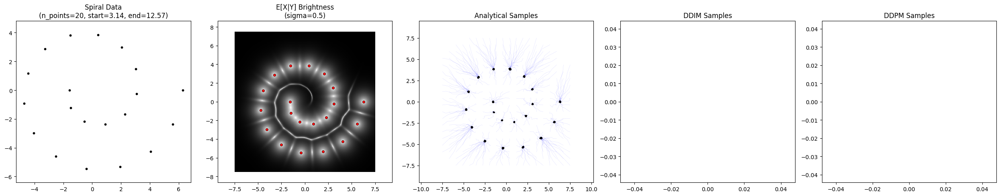

In [ ]:
n_points = 20
spiral_pow = 0.7
spiral_start = np.pi
spiral_end = 4 * np.pi
spiral_weighted_region = (2 * np.pi, 3 * np.pi)
spiral_weight = 1
sigma = 0.5
num_samples = 0
T = 10
epochs = 0 * T

# You can adjust num_epochs, T, batch_size, etc., if desired.
create_combined_figure(n_points=n_points,
                       spiral_start=spiral_start,
                       spiral_end=spiral_end,
                       spiral_pow=spiral_pow,
                       spiral_weighted_region=spiral_weighted_region,
                       spiral_weight=spiral_weight,
                       sigma=sigma,
                       num_samples=num_samples,
                       num_epochs=epochs,
                       T=T,
                       grid_range=(-7.5, 7.5),
                       sample_grid_resolution=20,
                       batch_size=128)

/var/folders/dd/314rfwxx4yngg6mlk2g73z500000gn/T/ipykernel_48893/1668583787.py:7: RuntimeWarning: invalid value encountered in divide
  return numerator / denominator


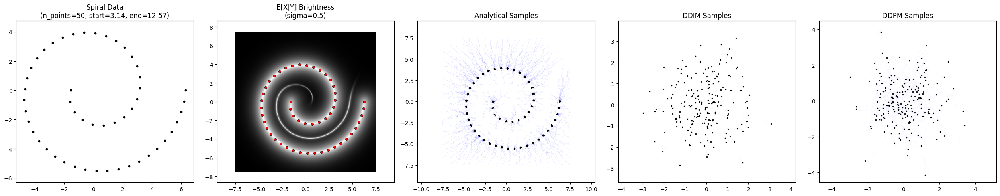

In [ ]:
n_points = 50
spiral_pow = 0.5
spiral_start = np.pi
spiral_end = 4 * np.pi
spiral_weighted_region = (2 * np.pi, 3 * np.pi)
spiral_weight = 1
sigma = 0.5
num_samples = 200
T = 20
epochs = 1000 * T
epochs = 0 * T

# You can adjust num_epochs, T, batch_size, etc., if desired.
create_combined_figure(n_points=n_points,
                       spiral_start=spiral_start,
                       spiral_end=spiral_end,
                       spiral_pow=spiral_pow,
                       spiral_weighted_region=spiral_weighted_region,
                       spiral_weight=spiral_weight,
                       sigma=sigma,
                       num_samples=num_samples,
                      #  num_epochs=20000,
                       num_epochs=epochs,
                       T=T,
                       grid_range=(-7.5, 7.5),
                       sample_grid_resolution=20,
                       batch_size=128)

# Create Animations

In [27]:
from matplotlib.patches import Rectangle
from matplotlib.animation import FuncAnimation, FFMpegWriter
from IPython import display

plt.rcParams["animation.ffmpeg_path"] = "/opt/homebrew/bin/ffmpeg"

In [28]:
def animate_samples(sample_func, sample_func_kwargs, title, interval=50):
  fig = plt.figure(figsize=(6, 6))

  ax_main = fig.add_axes([0.1, 0.2, 0.85, 0.7])
  ax_bar = fig.add_axes([0.1, 0.075, 0.85, 0.01])

  points_plotted, = ax_main.plot([], [], 'o', markersize=1, color="black")
  samples = sample_func(**sample_func_kwargs)

  T = len(samples)

  ax_main.set_xlim(-12.5, 12.5)
  ax_main.set_ylim(-12.5, 12.5)
  ax_main.axis("equal")
  ax_main.set_title(title)

  progress_rect = Rectangle((0, 0), 0, 1, color="blue")
  ax_bar.add_patch(progress_rect)
  ax_bar.set_xlim(0, T - 1)
  ax_bar.set_ylim(0, 0.5)
  ax_bar.axis("off")
  ax_bar.set_title("Time")

  def AnimationFunction(frame):
    traj = samples[frame]
    points_plotted.set_data(traj[:, 0], traj[:, 1])
    progress_rect.set_width(frame)
    return points_plotted, progress_rect

  anim_created = FuncAnimation(fig, AnimationFunction, frames=T, interval=interval, blit=True)
  video = anim_created.to_html5_video()
  display.display(display.HTML(video))
  plt.close(fig)

In [29]:
# x_points = generate_spiral(n_points, spiral_start, spiral_end, power, weighted_region=spiral_weighted_region, weight=spiral_weight)
x_points = generate_spiral(40, np.pi, 4 * np.pi, 0.5, weighted_region=(None, None), weight=1)
space = np.linspace(-15, 15, 100)
grid_x, grid_y = np.meshgrid(space, space)
grid_points = np.stack([grid_x.flatten(), grid_y.flatten()], axis=1)

T = 200

animate_samples(
    sample_func=sample_analytically,
    sample_func_kwargs={
         "x_points": x_points,
         "grid_points": grid_points,
         "T": T,
      },
    title="$E[X \mid Y]$ Sampling",
    interval=30,
)

/var/folders/dd/314rfwxx4yngg6mlk2g73z500000gn/T/ipykernel_4616/1668583787.py:7: RuntimeWarning: invalid value encountered in divide
  return numerator / denominator


In [31]:
T = 1000
epochs = 250

model, betas, alphas, alpha_bars, spiral_data = train_model_on_spiral(
      n_points=50,
      spiral_start=np.pi,
      spiral_end=4 * np.pi,
      spiral_pow=0.5,
      num_epochs=epochs,
      T=T,
      print_every=int(epochs / 20),
)


[n_points=50] Epoch 1/250, loss: 0.3993
[n_points=50] Epoch 12/250, loss: 0.2823
[n_points=50] Epoch 24/250, loss: 0.3150
[n_points=50] Epoch 36/250, loss: 0.2605
[n_points=50] Epoch 48/250, loss: 0.3078
[n_points=50] Epoch 60/250, loss: 0.2927
[n_points=50] Epoch 72/250, loss: 0.4899
[n_points=50] Epoch 84/250, loss: 0.3773
[n_points=50] Epoch 96/250, loss: 0.4669
[n_points=50] Epoch 108/250, loss: 0.2746
[n_points=50] Epoch 120/250, loss: 0.3665
[n_points=50] Epoch 132/250, loss: 0.4242
[n_points=50] Epoch 144/250, loss: 0.4922
[n_points=50] Epoch 156/250, loss: 0.2487
[n_points=50] Epoch 168/250, loss: 0.4170
[n_points=50] Epoch 180/250, loss: 0.3702
[n_points=50] Epoch 192/250, loss: 0.2843
[n_points=50] Epoch 204/250, loss: 0.2598
[n_points=50] Epoch 216/250, loss: 0.2180
[n_points=50] Epoch 228/250, loss: 0.4198
[n_points=50] Epoch 240/250, loss: 0.4975


In [32]:
animate_samples(
    sample_func=sample_ddpm,
    sample_func_kwargs={
        "model": model,
        "num_samples": 10000,
        "alpha_bars": alpha_bars,
        "alphas": alphas,
        "betas": betas,
        "device": device,
        "T": T
      },
    title="DDPM Sampling",
    interval=25,
)

In [33]:
animate_samples(
    sample_func=sample_ddim,
    sample_func_kwargs={
        "model": model,
        "num_samples": 10000,
        "alpha_bars": alpha_bars,
        "device": device,
        "T": T
    },
    title="DDIM Sampling",
    interval=25,
)

In [37]:
T = 500
epochs = 250

model_flow, spiral_data = train_flow_matching_model_on_spiral(
    n_points=50,
    T=T,
    num_epochs=epochs,
    print_every=int(epochs / 20),
    spiral_pow=0.5
)

Epoch 1/250, Loss: 5.906625
Epoch 12/250, Loss: 4.465574
Epoch 24/250, Loss: 4.452149
Epoch 36/250, Loss: 4.412695
Epoch 48/250, Loss: 4.389013
Epoch 60/250, Loss: 4.397552
Epoch 72/250, Loss: 4.357009
Epoch 84/250, Loss: 4.384604
Epoch 96/250, Loss: 4.439393
Epoch 108/250, Loss: 4.384741
Epoch 120/250, Loss: 4.473250
Epoch 132/250, Loss: 4.355197
Epoch 144/250, Loss: 4.404854
Epoch 156/250, Loss: 4.384507
Epoch 168/250, Loss: 4.362694
Epoch 180/250, Loss: 4.416367
Epoch 192/250, Loss: 4.395463
Epoch 204/250, Loss: 4.324727
Epoch 216/250, Loss: 4.394755
Epoch 228/250, Loss: 4.355633
Epoch 240/250, Loss: 4.352253


In [38]:
animate_samples(
    sample_func=sample_flow_matching,
    sample_func_kwargs={
        "model": model_flow,
        "num_samples": 10000,
        "T": T
    },
    title="Flow Matching Sampling",
    interval=25,
)